# Additional simulations with Elastic Net

In [1]:
using StatsPlots
using Plots
using DataFrames
using CSV
using Statistics

abs_project_path = normpath(joinpath(@__FILE__,"..", "..", ".."))
include(joinpath(abs_project_path, "utilities", "multiple_plots.jl"));

In [2]:
methods_to_evaluate = ["Rand_MS", "DS", "MDS"];

## Simulation with Beta Random draw from Normal distribution and ElasticNet with alpha=0.7

In [3]:
results_path = joinpath(abs_project_path, "results", "n_800_p_2000_alpha_enet_7_beta_type_random")
df_EN7_Beta_Rand = CSV.read(joinpath(results_path, "all_metrics.csv"), DataFrames.DataFrame)
df_EN7_Beta_Rand = df_EN7_Beta_Rand[df_EN7_Beta_Rand.successsfull_run .== 1., :];

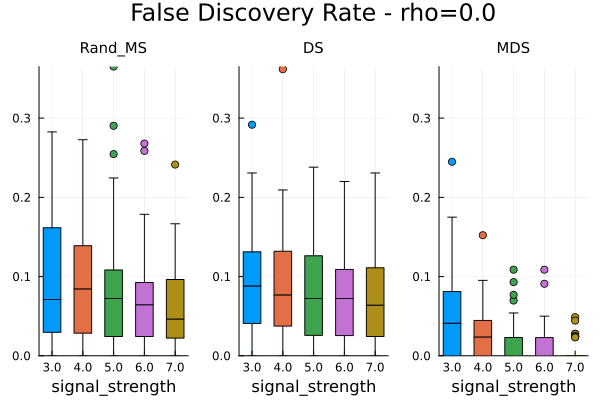

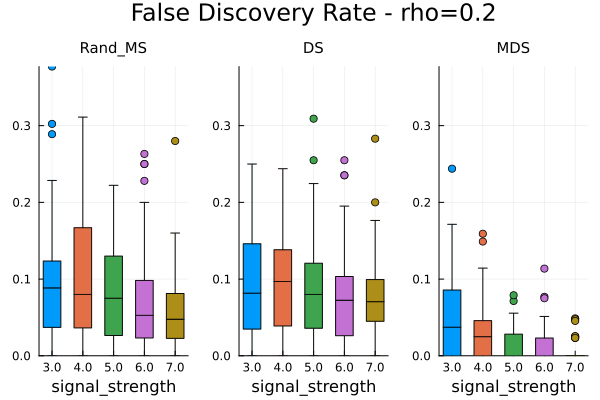

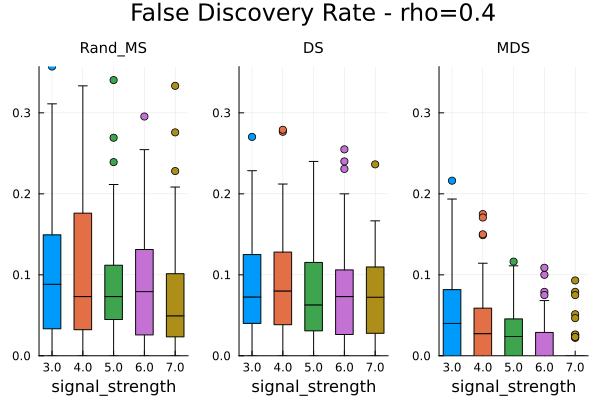

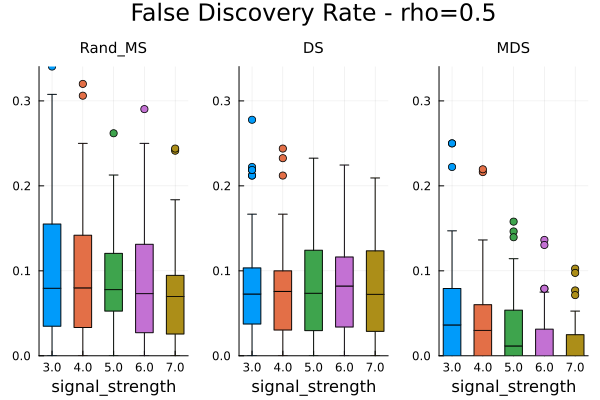

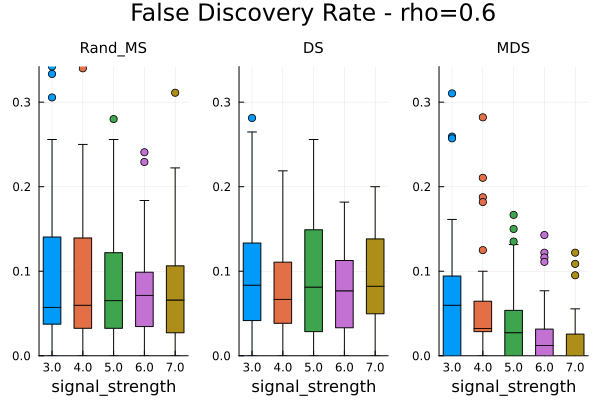

...

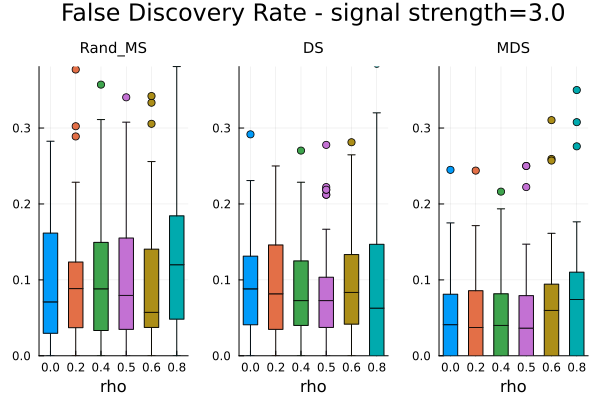

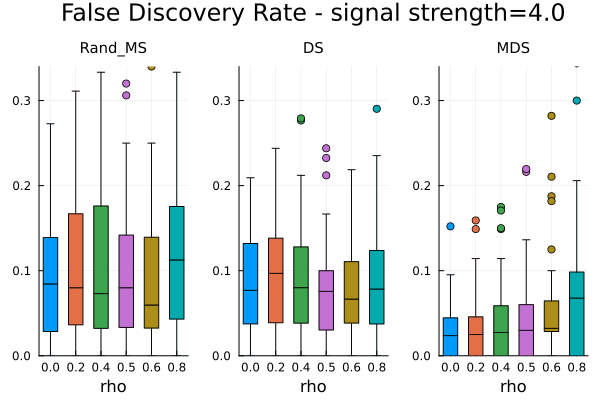

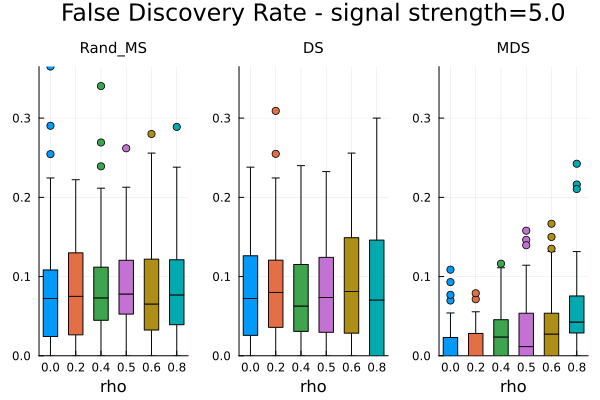

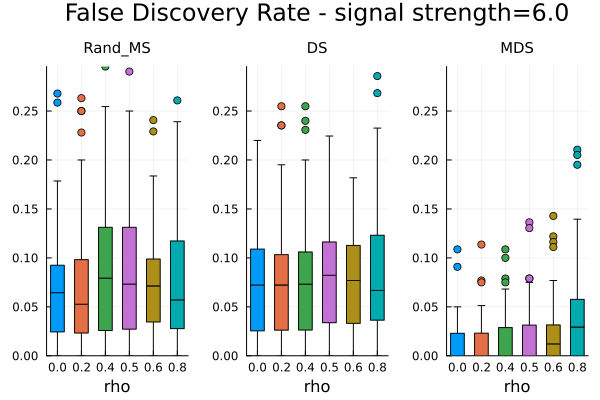

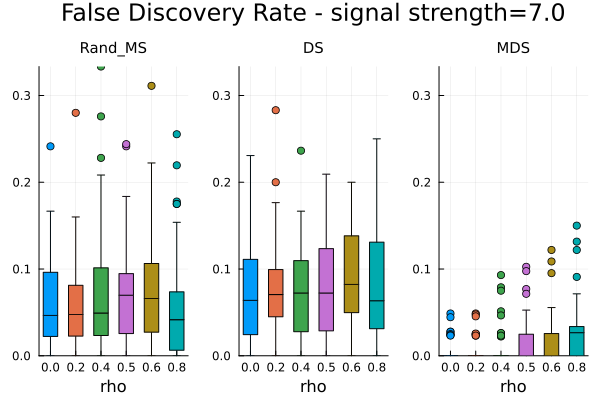

In [17]:
plot_all(
    df=df_EN7_Beta_Rand, var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
    )

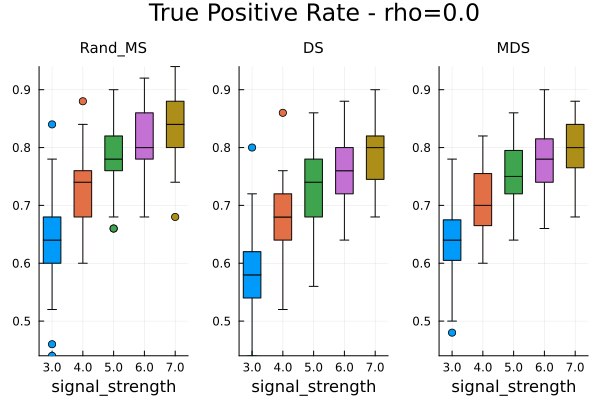

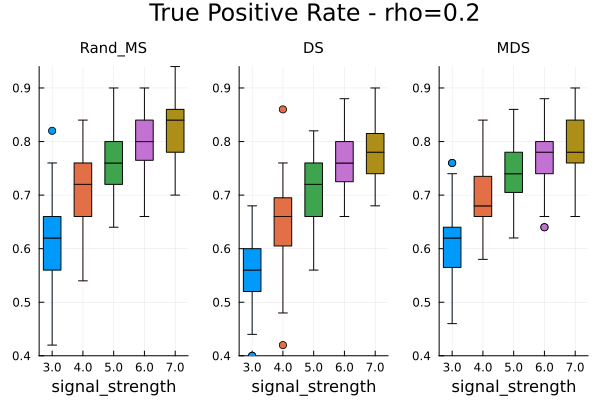

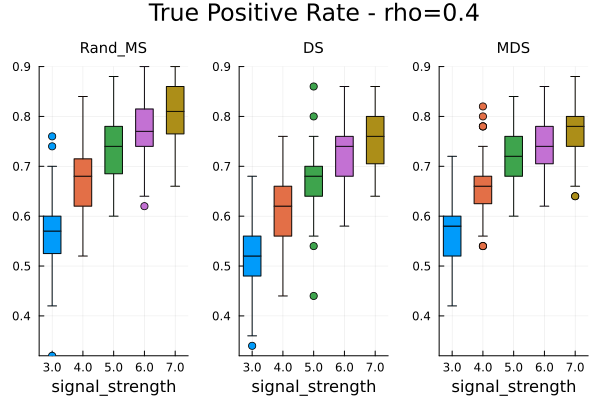

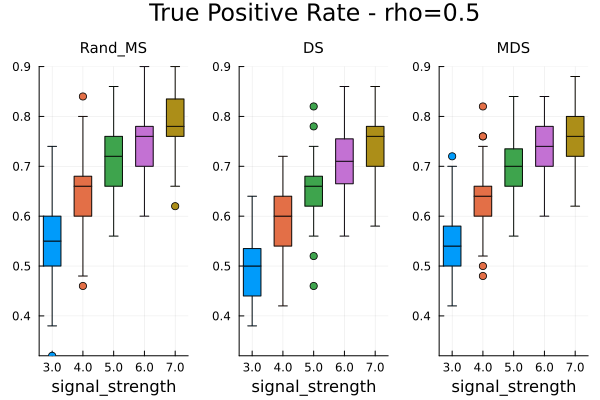

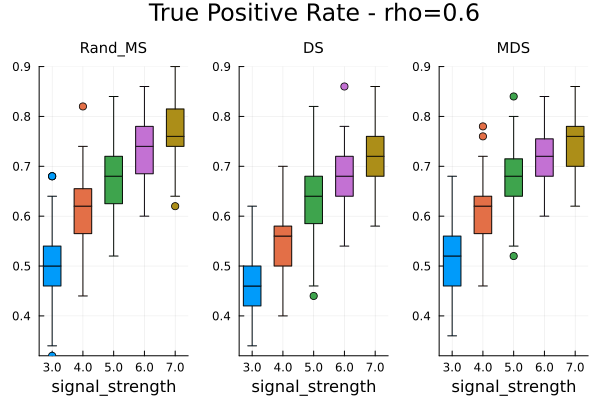

...

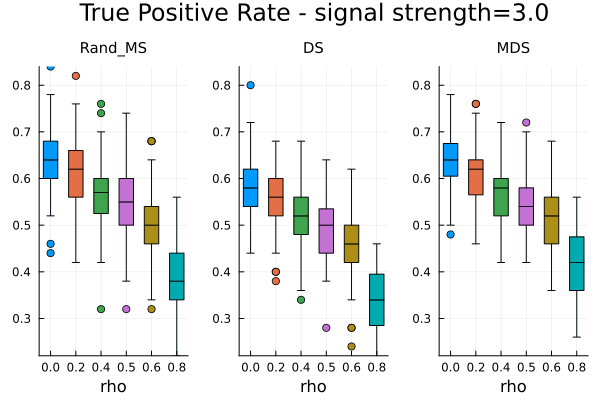

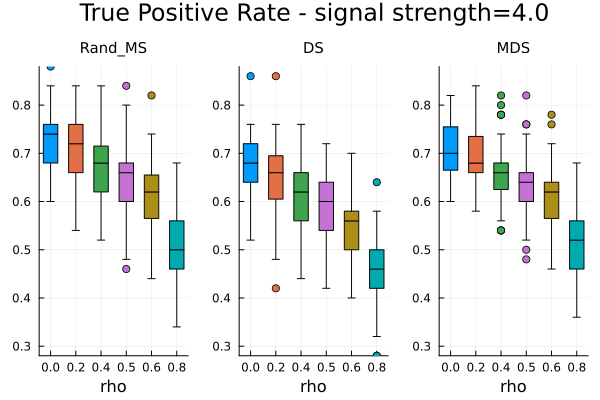

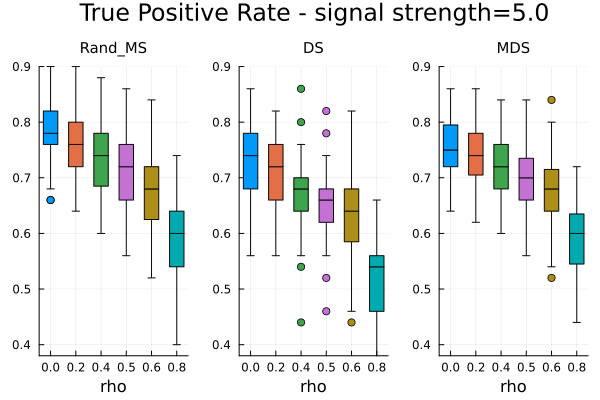

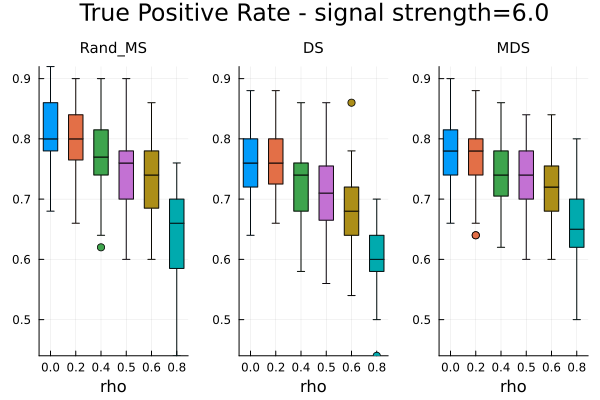

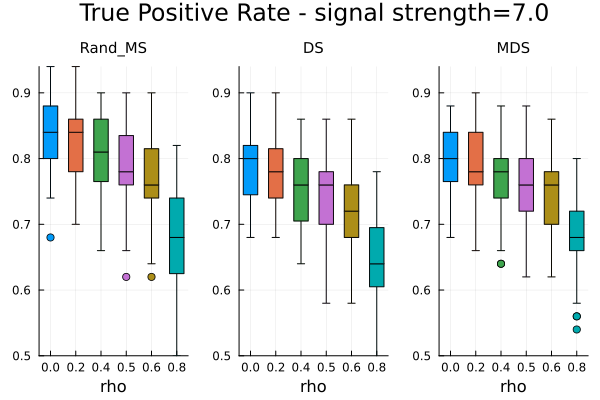

In [19]:
plot_all(
    df=df_EN7_Beta_Rand, var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
    )

## Simulation with Beta from fixed pool and ElasticNet with alpha=0.7

In [20]:
results_path = joinpath(abs_project_path, "results", "n_800_p_2000_alpha_enet_7_beta_type_pool")
df_EN7_Beta_Pool = CSV.read(joinpath(abs_project_path, "results", "n_800_p_2000_alpha_enet_7_beta_type_pool", "all_metrics.csv"), DataFrames.DataFrame)
df_EN7_Beta_Pool = df_EN7_Beta_Pool[df_EN7_Beta_Pool.successsfull_run .== 1., :];

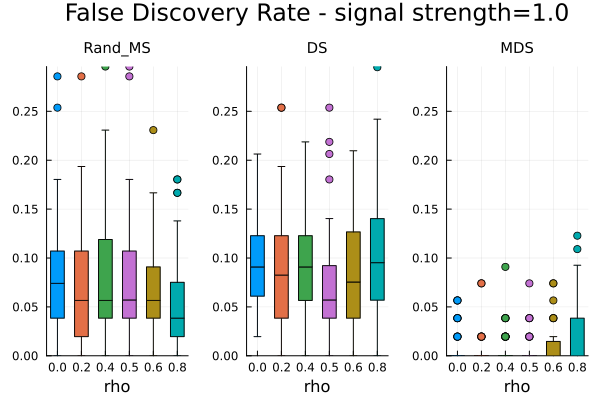

In [21]:
plot_all(df=df_EN7_Beta_Pool, var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

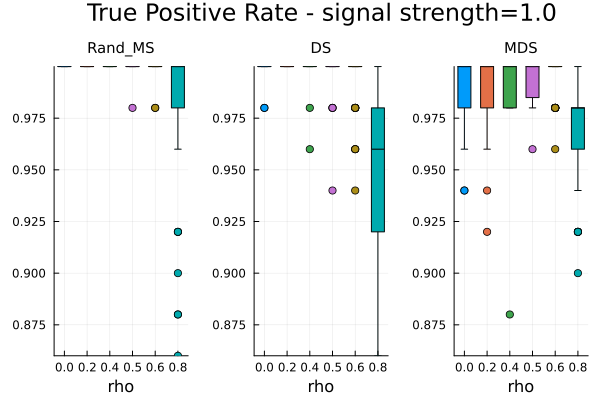

In [22]:
plot_all(df=df_EN7_Beta_Pool, var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
save_plot=true, plot_path=results_path
)

## Simulation with Beta Random draw from Normal distribution and Lasso

In [10]:
df = CSV.read(joinpath(abs_project_path, "results", "n_800_p_2000_alpha_enet_10_beta_type_random", "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

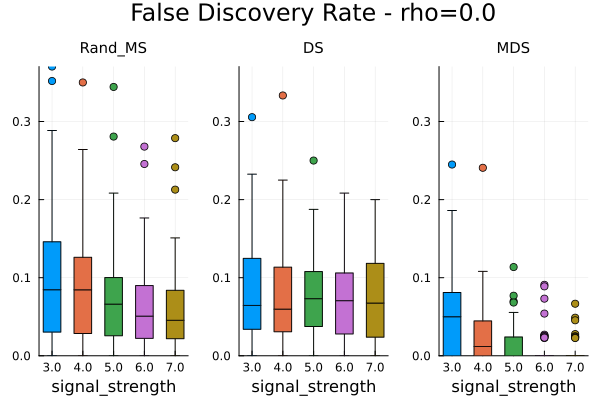

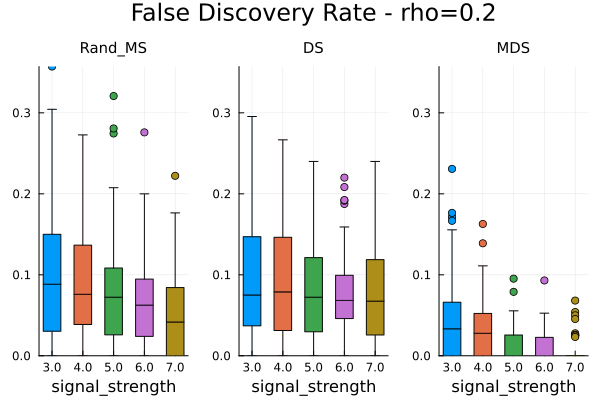

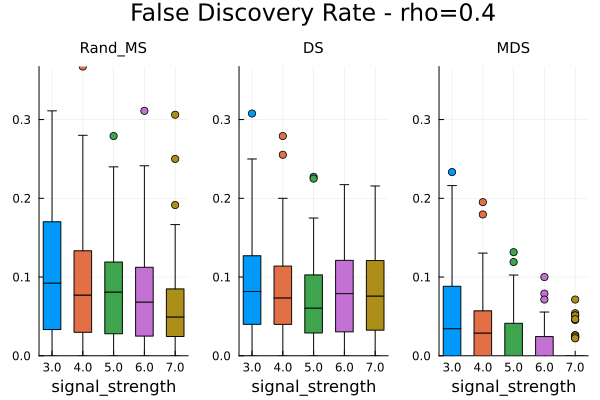

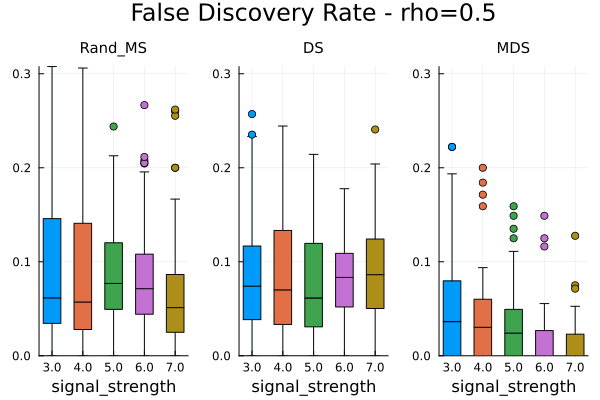

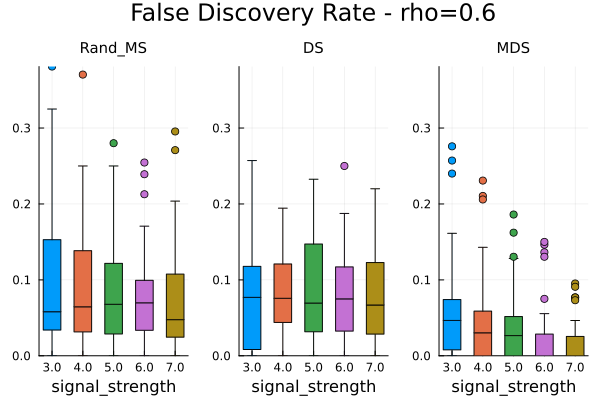

...

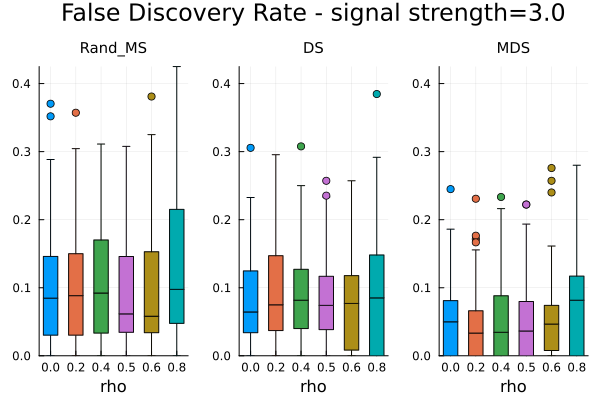

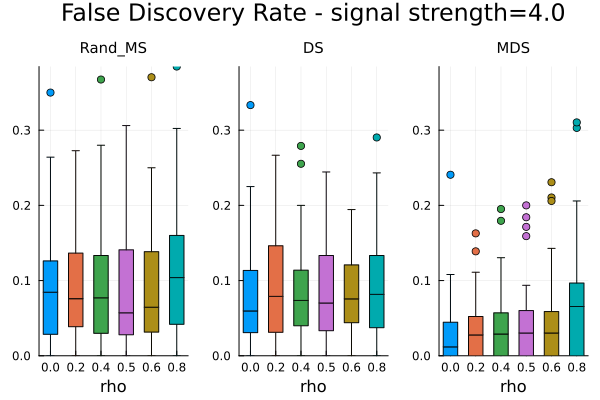

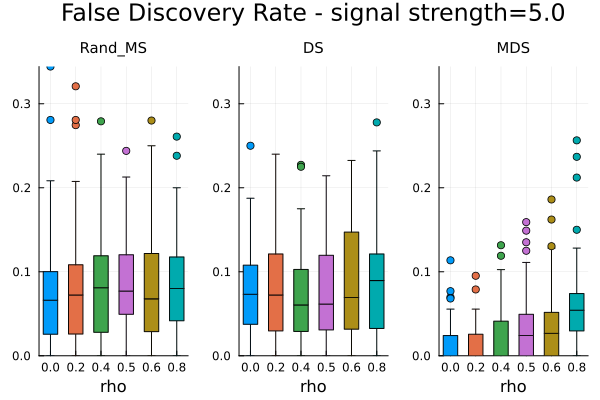

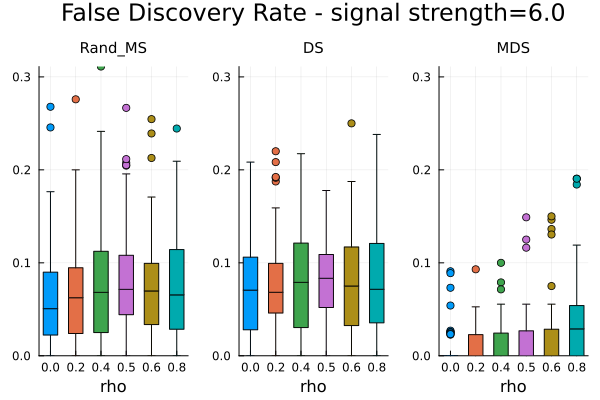

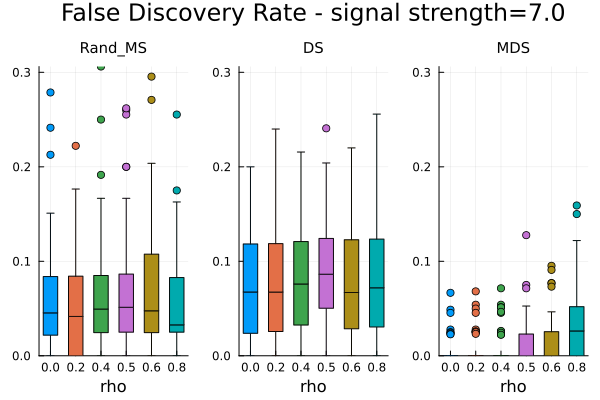

In [11]:
plot_all(df=df, var_columns="fdr", methods_to_evaluate=methods_to_evaluate)

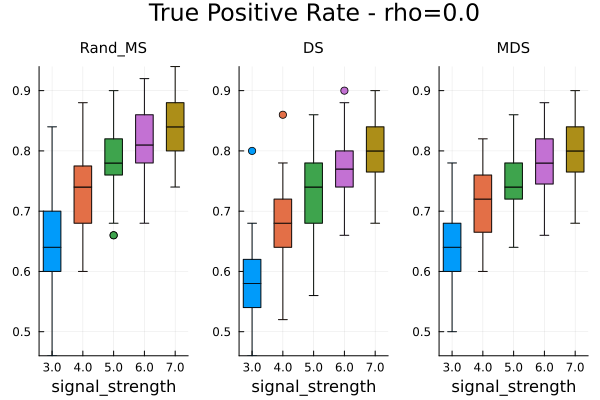

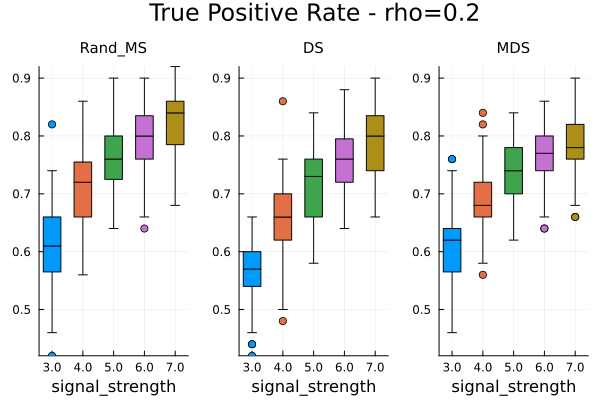

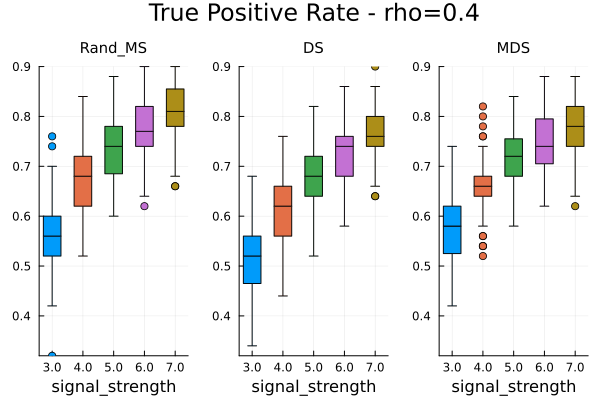

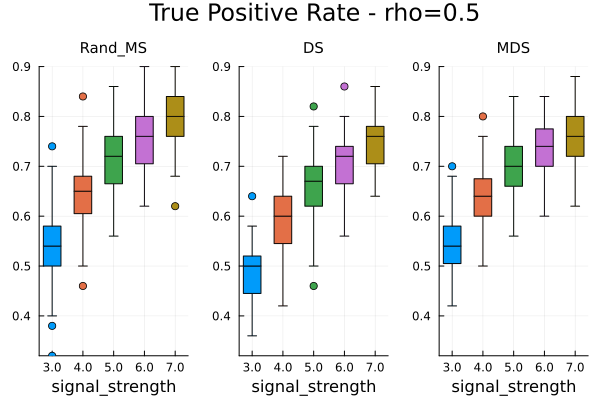

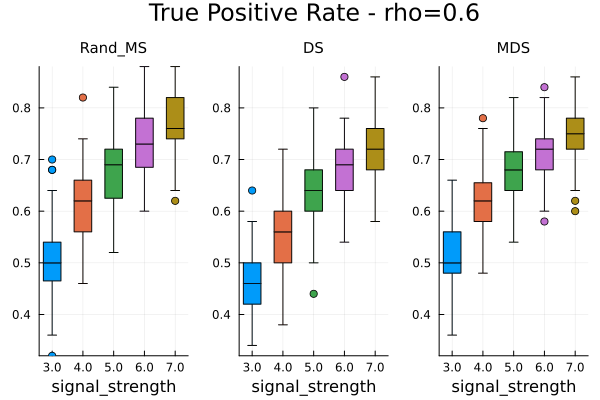

...

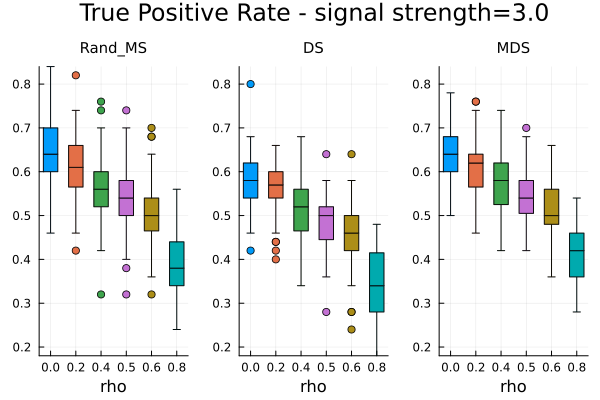

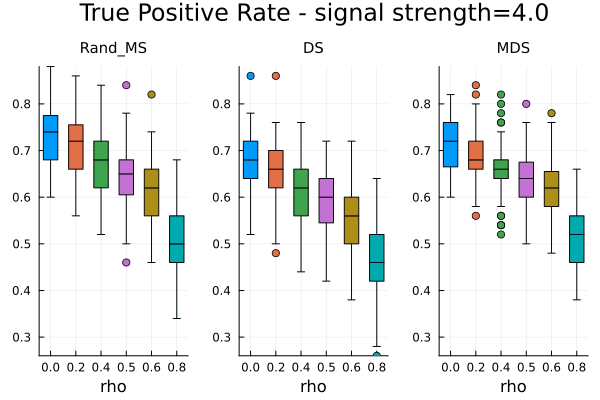

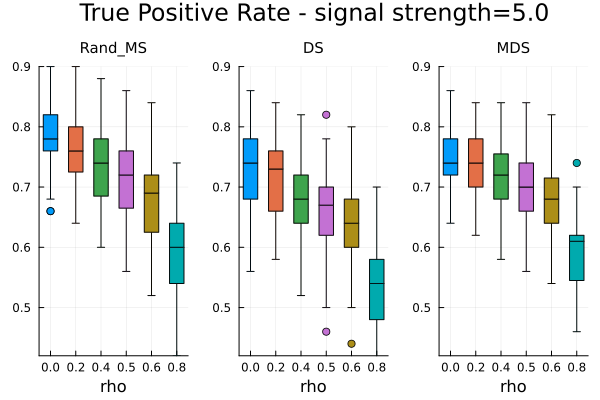

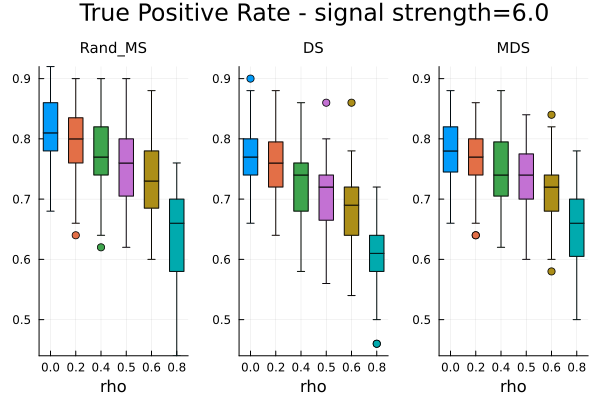

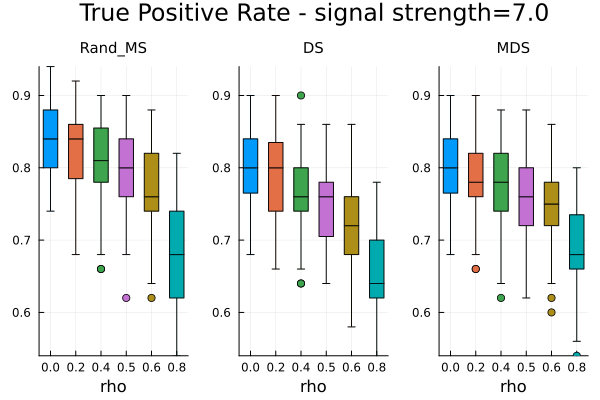

In [12]:
plot_all(df=df, var_columns="tpr", methods_to_evaluate=methods_to_evaluate)

## Simulation with Beta from fixed pool and Lasso

In [23]:
results_path = joinpath(abs_project_path, "results", "n_800_p_2000_alpha_enet_10_beta_type_pool")
df = CSV.read(joinpath(abs_project_path, "results", "n_800_p_2000_alpha_enet_10_beta_type_pool", "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

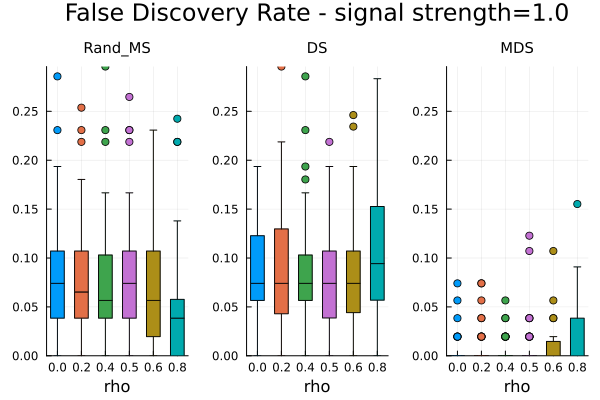

In [24]:
plot_all(
    df=df, var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

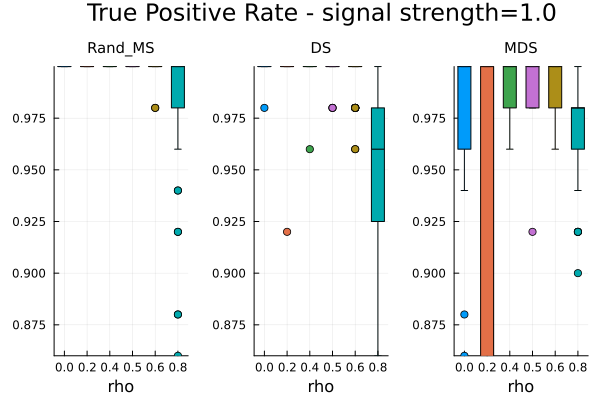

In [25]:
plot_all(
    df=df, var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
    )

# Very high variance

## Simulation with Beta from fixed pool and Lasso

In [11]:
df = CSV.read(joinpath(abs_project_path, "results", "n_800_p_1000_alpha_enet_10_beta_type_pool", "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

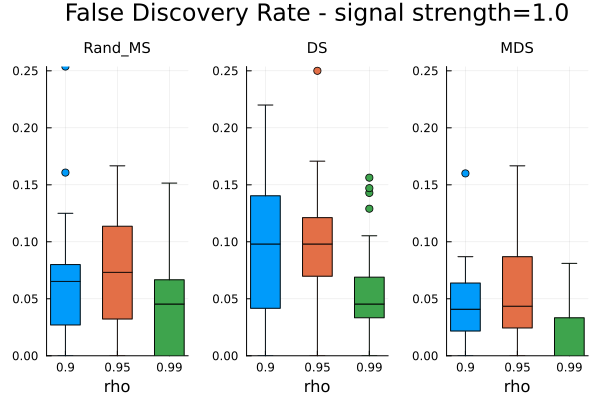

In [12]:
plot_all(df=df, var_columns="fdr", methods_to_evaluate=methods_to_evaluate)

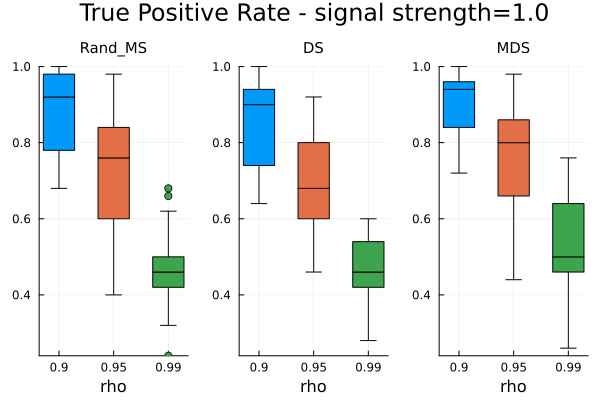

In [13]:
plot_all(df=df, var_columns="tpr", methods_to_evaluate=methods_to_evaluate)

## Simulation with Beta from fixed pool and ElasticNet 0.7

In [14]:
df = CSV.read(joinpath(abs_project_path, "results", "n_800_p_1000_alpha_enet_7_beta_type_pool", "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

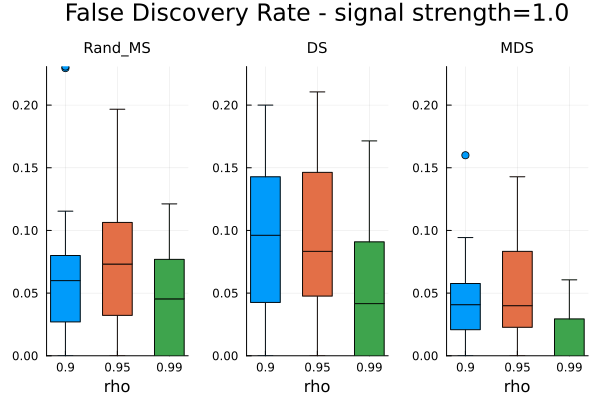

In [15]:
plot_all(df=df, var_columns="fdr", methods_to_evaluate=methods_to_evaluate)

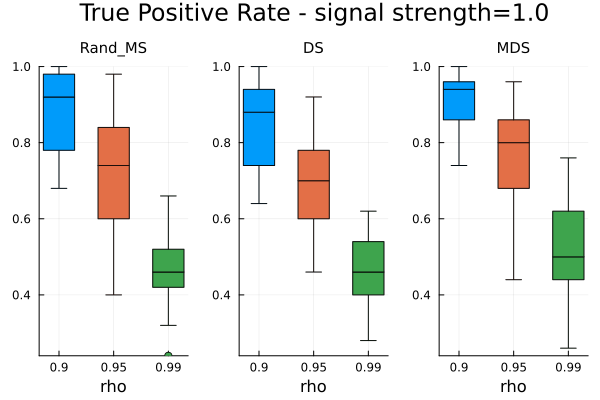

In [16]:
plot_all(df=df, var_columns="tpr", methods_to_evaluate=methods_to_evaluate)

# Near ill-conditioned covariance matrix

### Lasso, n=800, p=1000

In [12]:
results_path = joinpath(abs_project_path, "results", "2023113_ill_cov", "n_800_p_1000_alpha_enet_10_beta_type_pool_cov_like_paper_false")
df = CSV.read(joinpath(results_path, "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

In [13]:
unique(df[:, ["cov_eigval", "rho", "prop_non_zero"]])

Row,cov_eigval,rho,prop_non_zero
,Float64,Float64,Float64
1,0.400004,0.3,0.1
2,0.400005,0.3,0.2
3,0.400003,0.3,0.025
4,0.400006,0.3,0.3
5,0.400003,0.3,0.05
6,0.200005,0.4,0.1
7,0.200006,0.4,0.2
8,0.200004,0.4,0.025
9,0.200008,0.4,0.3


#### Prop non-0: 2.5%

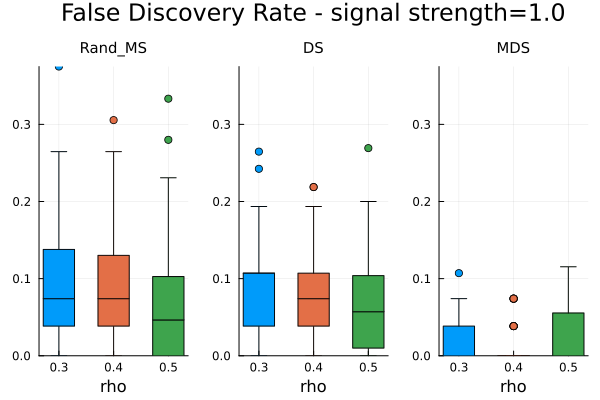

In [14]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.025, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

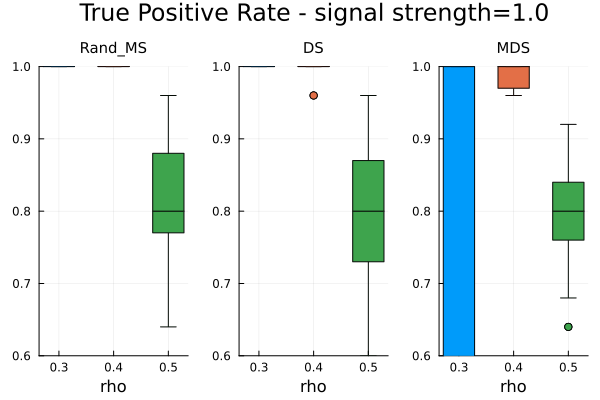

In [15]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.025, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

#### Prop non-0: 10%

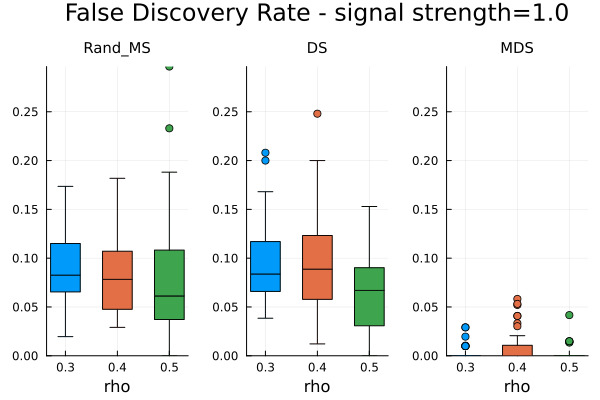

In [16]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.1, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
    )

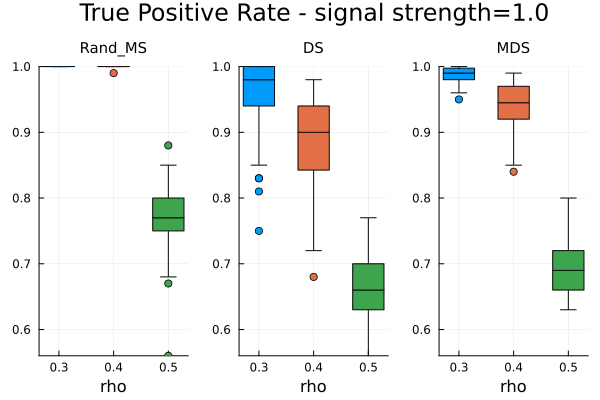

In [17]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.1, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
    )

#### Prop non-0: 30%

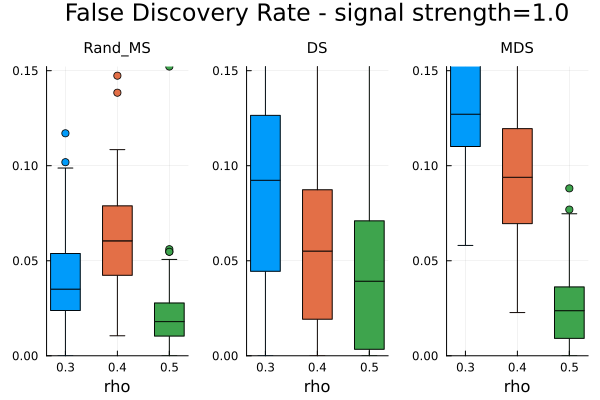

In [18]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.3, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
    )

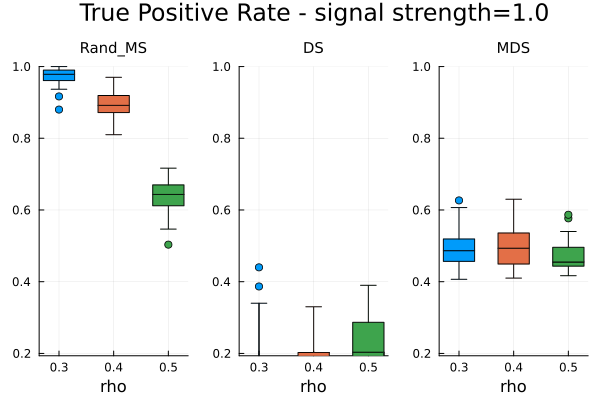

In [19]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.3, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
    )

### Lasso, n=800, p=2000

In [25]:
df = CSV.read(joinpath(abs_project_path, "results", "n_800_p_2000_alpha_enet_10_beta_type_pool_cov_like_paper_false", "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

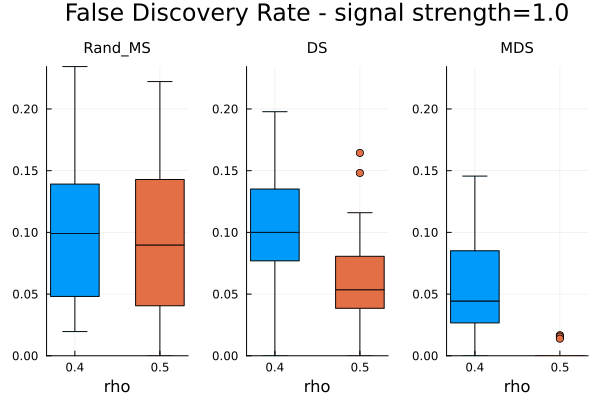

In [26]:
plot_all(df=df, var_columns="fdr", methods_to_evaluate=methods_to_evaluate)

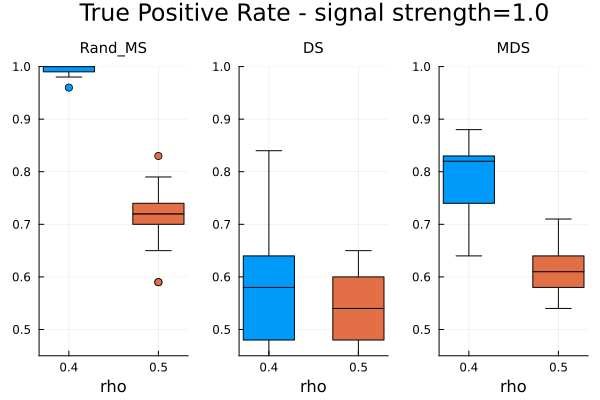

In [27]:
plot_all(df=df, var_columns="tpr", methods_to_evaluate=methods_to_evaluate)

### Elastic Net 0.7

In [21]:
df = CSV.read(joinpath(abs_project_path, "results", "n_800_p_1000_alpha_enet_7_beta_type_pool_cov_like_paper_false", "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

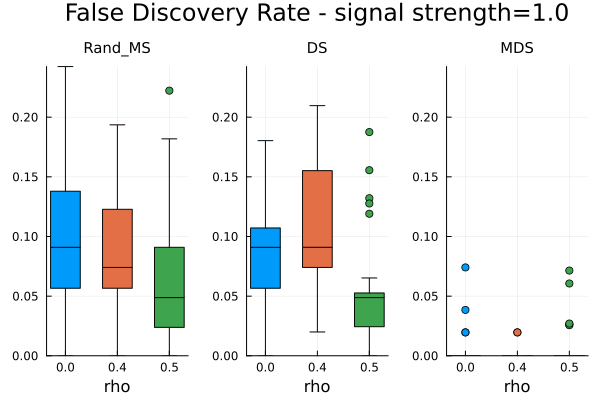

In [22]:
plot_all(df=df, var_columns="fdr", methods_to_evaluate=methods_to_evaluate)

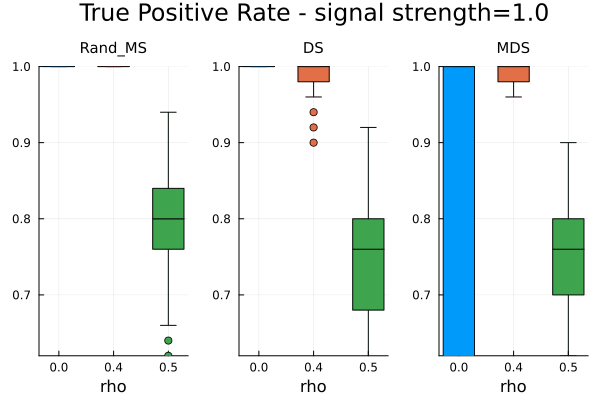

In [23]:
plot_all(df=df, var_columns="tpr", methods_to_evaluate=methods_to_evaluate)

# Covariance like paper, but higher percentage of non-0 coefficients

### Lasso

In [38]:
results_path = joinpath(abs_project_path, "results", "n_800_p_1000_alpha_enet_10_beta_type_pool_cov_like_paper_true")
df = CSV.read(joinpath(abs_project_path, "results", "n_800_p_1000_alpha_enet_10_beta_type_pool_cov_like_paper_true", "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

In [41]:
unique(df[:, "prop_non_zero"])

5-element Vector{Float64}:
 0.1
 0.2
 0.025
 0.3
 0.05

#### Percentage non zero: 2.5%

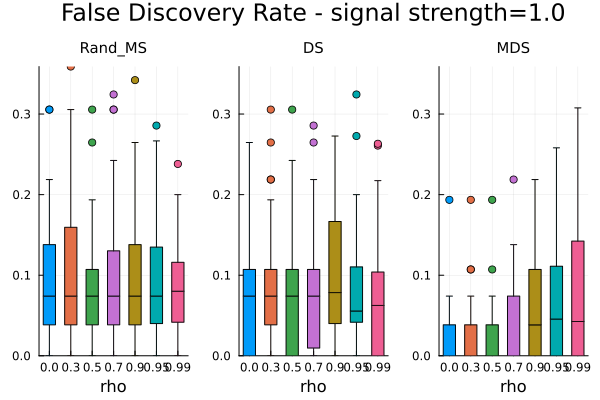

In [42]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.025, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
    )

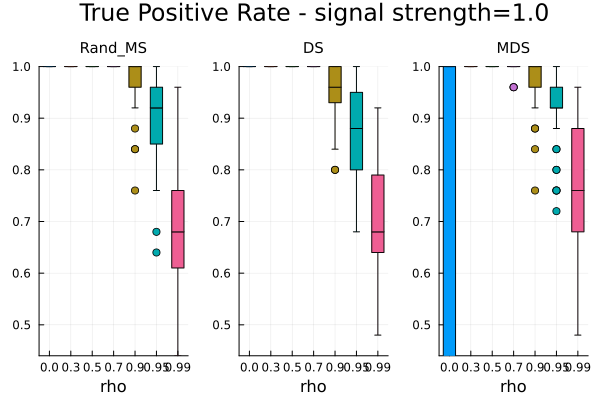

In [7]:
plot_all(df=df[df[:, "prop_non_zero"] .== 0.025, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate)

#### Percentage non zero: 10%

In [58]:
Plots.scalefontsizes(0.8)

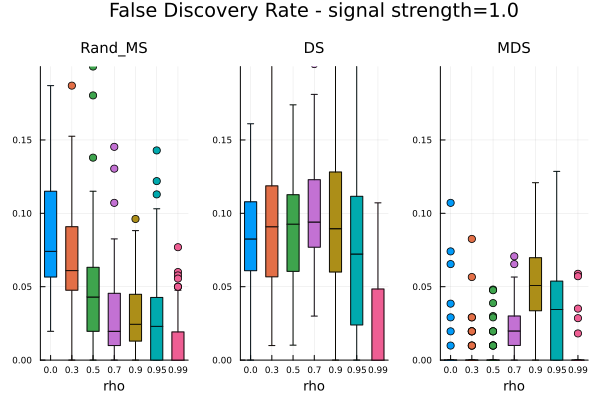

In [59]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.1, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
    )

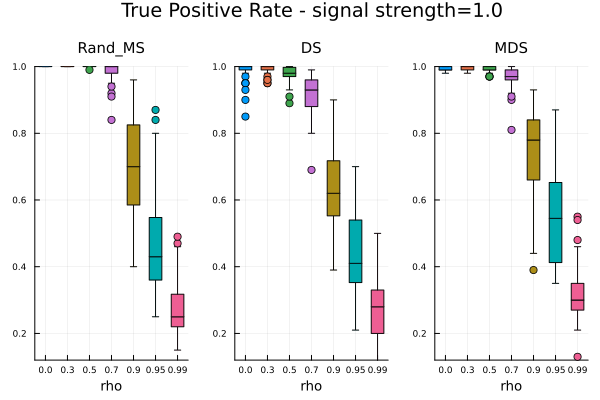

In [60]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.1, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

#### Percentage non-0: 20%

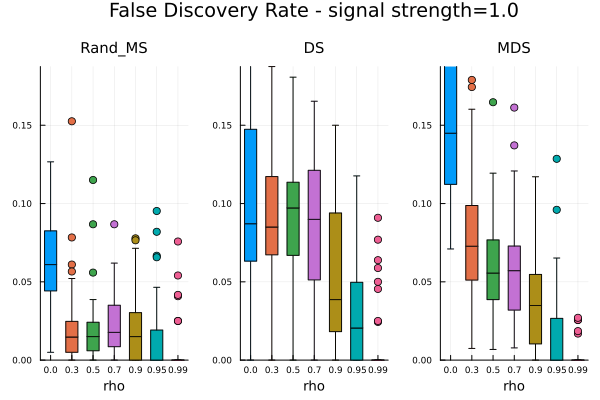

In [61]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.2, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

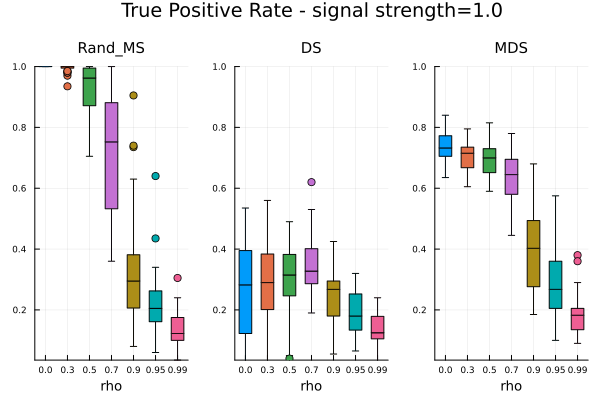

In [62]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.2, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

#### Percentage non-0: 30%

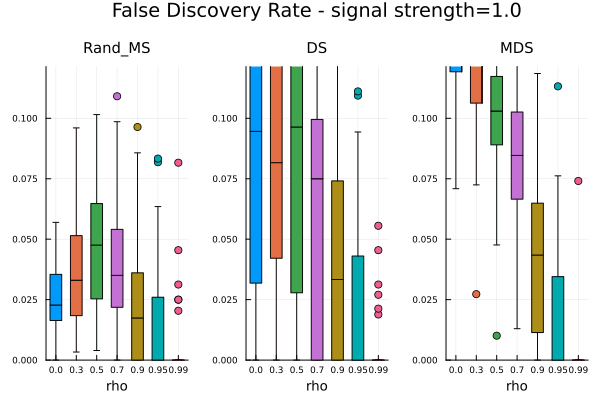

In [63]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.3, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

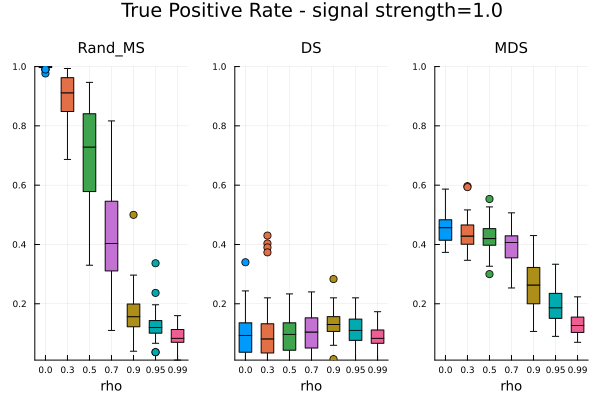

In [64]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.3, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

### Elastic Net 0.7

In [14]:
df = CSV.read(joinpath(abs_project_path, "results", "n_800_p_1000_alpha_enet_7_beta_type_pool_cov_like_paper_true", "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

#### Percentage non-0: 2.5%

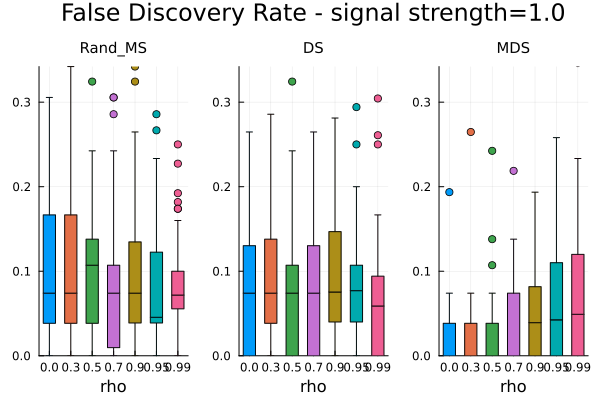

In [15]:
plot_all(df=df[df[:, "prop_non_zero"] .== 0.025, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate)

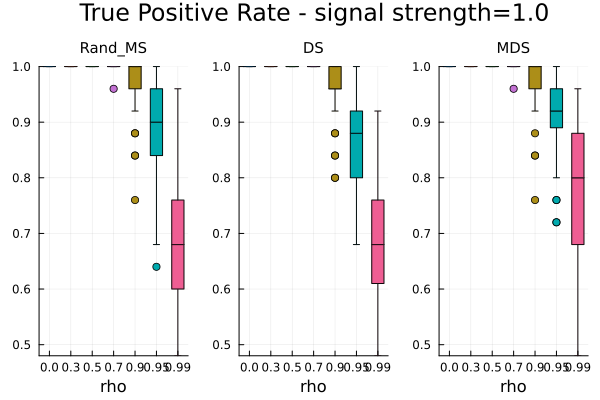

In [16]:
plot_all(df=df[df[:, "prop_non_zero"] .== 0.025, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate)

#### Percentage non-0: 10%

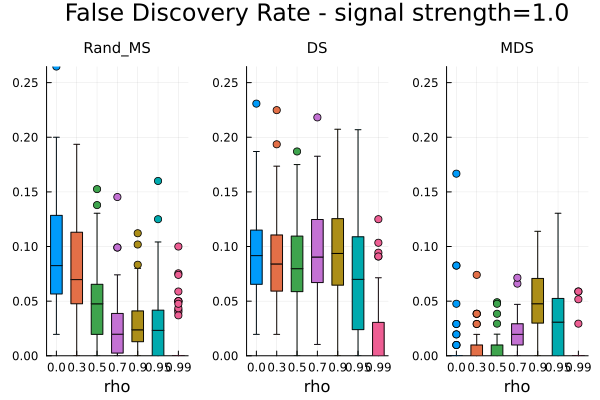

In [17]:
plot_all(df=df[df[:, "prop_non_zero"] .== 0.1, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate)

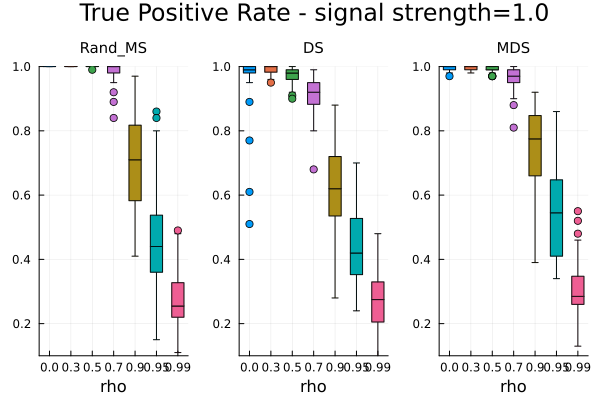

In [18]:
plot_all(df=df[df[:, "prop_non_zero"] .== 0.1, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate)

#### Percentage non-0: 30%

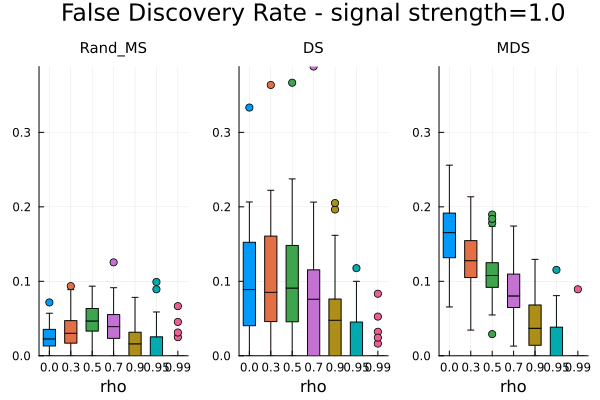

In [19]:
plot_all(df=df[df[:, "prop_non_zero"] .== 0.3, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate)

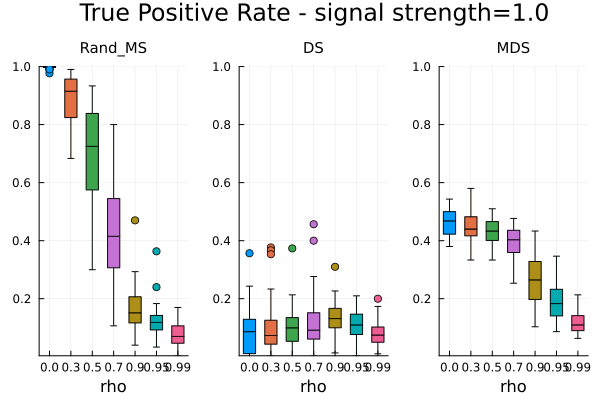

In [20]:
plot_all(df=df[df[:, "prop_non_zero"] .== 0.3, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate)

# Full Covariance (like paper) but not block structure 

### ElasticNet

In [3]:
results_path = joinpath(abs_project_path, "results", "n_800_p_1000_alpha_enet_7_beta_type_pool_no_block")
df = CSV.read(joinpath(results_path, "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

In [4]:
unique(df[:, "prop_non_zero"])

4-element Vector{Float64}:
 0.1
 0.2
 0.3
 0.05

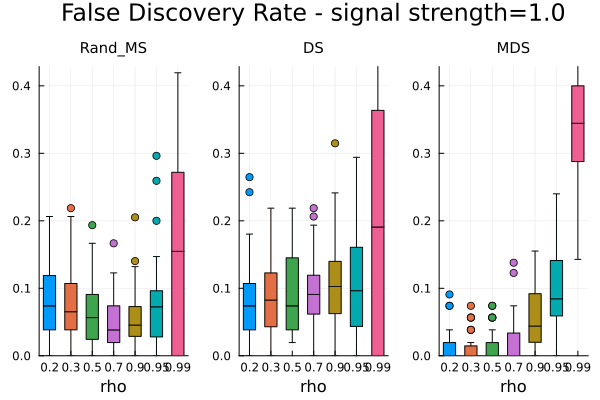

In [5]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.05, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

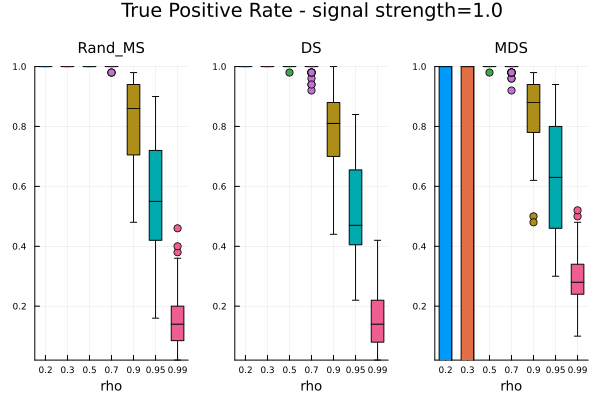

In [70]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.05, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

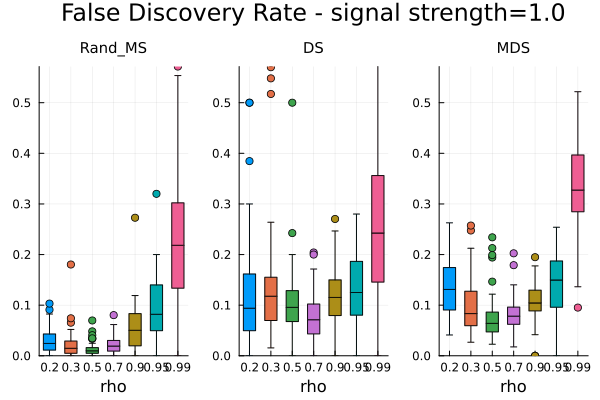

In [6]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.20, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

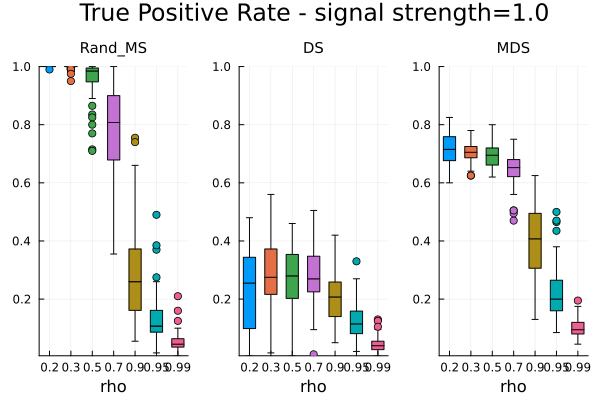

In [7]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.2, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

### Lasso

In [4]:
results_path = joinpath(abs_project_path, "results", "n_800_p_1000_alpha_enet_10_beta_type_pool_no_block")
df = CSV.read(joinpath(results_path, "all_metrics.csv"), DataFrames.DataFrame)
df = df[df.successsfull_run .== 1., :];

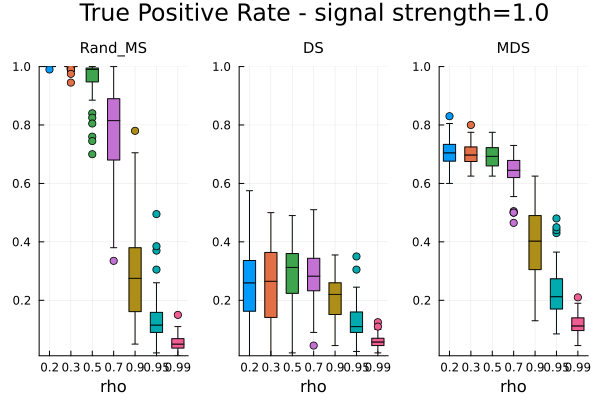

In [5]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.2, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

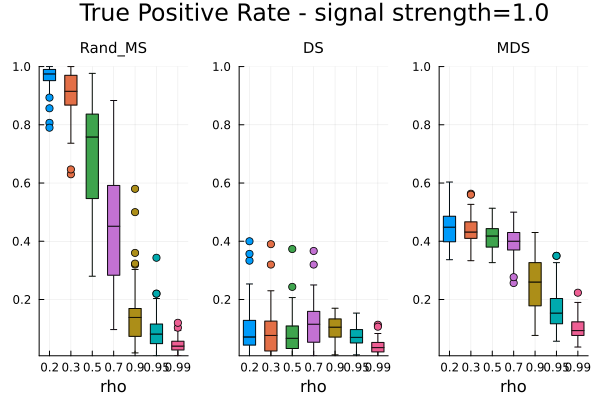

In [6]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.3, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

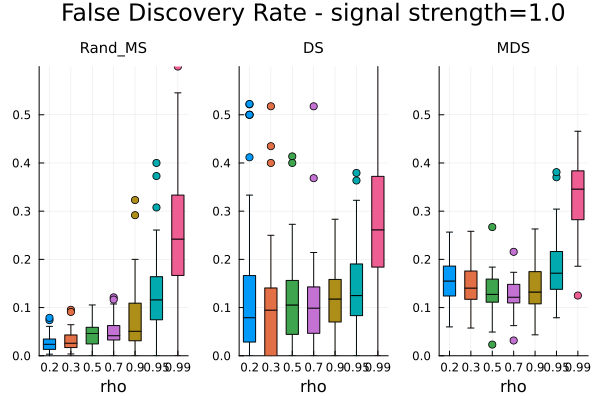

In [9]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.3, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

# p = 5000

In [8]:
results_path = joinpath(abs_project_path, "results", "n_800_p_5000_alpha_enet_10_beta_type_pool_cov_like_paper_true")
df = CSV.read(joinpath(results_path, "all_metrics.csv"), DataFrames.DataFrame);

In [9]:
methods_to_evaluate = ["Rand_MS", "DS", "MDS"];

In [10]:
df = df[df.successsfull_run .== 1., :];

In [11]:
unique(df[:, "prop_non_zero"])

4-element Vector{Float64}:
 0.1
 0.025
 0.05
 0.002

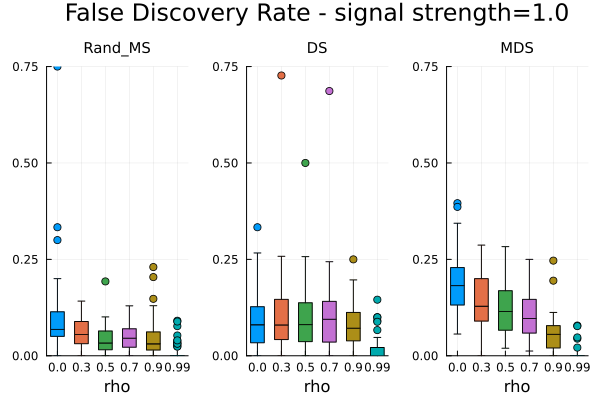

In [12]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.025, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

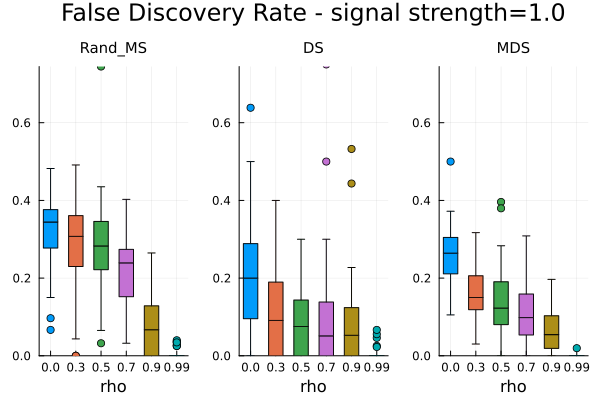

In [14]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.05, :], var_columns="fdr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)

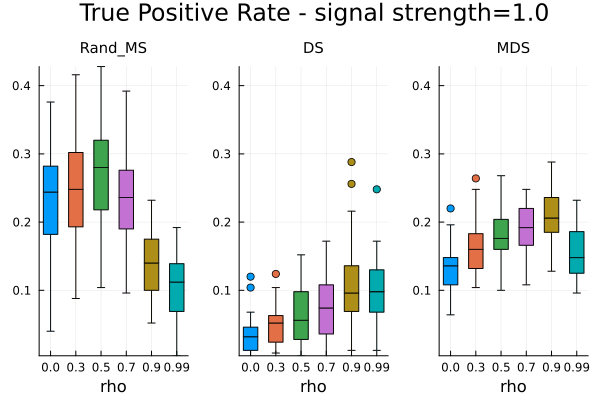

In [15]:
plot_all(
    df=df[df[:, "prop_non_zero"] .== 0.05, :], var_columns="tpr", methods_to_evaluate=methods_to_evaluate,
    save_plot=true, plot_path=results_path
)